find the reason of which,how and why certain categories seems to be trending and why certain categories are not, because we want to predict the trending categories, explore everything, and create a column which defines whether a category is trending (1) or not (0) binary classification

##########################

'video_id', 'trending_date', 'title', 'channel_title', 'category_id', 'publish_time', 'tags', 'views', 'likes', 'dislikes', 'comment_count', 'comments_disabled', 'ratings_disabled', 'video_error_or_removed',
'description', 'category', 'sum_stats', 'trending'


In [309]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import datetime
from datetime import date

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
sns.set_style("whitegrid")

import chart_studio.plotly as py
import cufflinks as cf
import plotly.express as px

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

cf.go_offline()

import pandas_profiling
import plotly.graph_objects as go

from wordcloud import WordCloud,STOPWORDS
from sklearn.feature_extraction.text import CountVectorizer

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

In [310]:
df = pd.read_csv('UStrends.csv')
df.rename(columns = {'trend':'trending'}, inplace = True)
df.drop(['Unnamed: 0.1','thumbnail_link','video_id'],axis=1,inplace=True)
df.head(5)
# trend of a category was calculated by summing the views, likes and comment_count minus by dislikes, sum_stats 
# column was created with result of these calculations then sum_stats mean was taken and the values greater than
# that mean is considered trending (1) and values less than that mean are considered as non trending (0). 

,Unnamed: 0,trending_date,title,channel_title,category_id,publish_time,tags,views,likes,dislikes,comment_count,comments_disabled,ratings_disabled,video_error_or_removed,description,category,sum_stats,trending
0,0,17.14.11,WE WANT TO TALK ABOUT OUR MARRIAGE,CaseyNeistat,22.0,2017-11-13T17:13:01.000Z,SHANtell martin,748374.0,57527.0,2966.0,15954.0,False,False,False,SHANTELL'S CHANNEL - https://www.youtube.com/s...,People & Blogs,818889.0,0
1,1,17.14.11,The Trump Presidency: Last Week Tonight with J...,LastWeekTonight,24.0,2017-11-13T07:30:00.000Z,"last week tonight trump presidency|""last week ...",2418783.0,97185.0,6146.0,12703.0,False,False,False,"One year after the presidential election, John...",Entertainment,2522525.0,1
2,2,17.14.11,"Racist Superman | Rudy Mancuso, King Bach & Le...",Rudy Mancuso,23.0,2017-11-12T19:05:24.000Z,"racist superman|""rudy""|""mancuso""|""king""|""bach""...",3191434.0,146033.0,5339.0,8181.0,False,False,False,WATCH MY PREVIOUS VIDEO ▶ \n\nSUBSCRIBE ► http...,Comedy,3340309.0,1
3,3,17.14.11,Nickelback Lyrics: Real or Fake?,Good Mythical Morning,24.0,2017-11-13T11:00:04.000Z,"rhett and link|""gmm""|""good mythical morning""|""...",343168.0,10172.0,666.0,2146.0,False,False,False,Today we find out if Link is a Nickelback amat...,Entertainment,354820.0,0
4,4,17.14.11,I Dare You: GOING BALD!?,nigahiga,24.0,2017-11-12T18:01:41.000Z,"ryan|""higa""|""higatv""|""nigahiga""|""i dare you""|""...",2095731.0,132235.0,1989.0,17518.0,False,False,False,I know it's been a while since we did this sho...,Entertainment,2243495.0,0


In [311]:
px.line(df,x='trending_date',y=['views','likes','comment_count'],labels={'value':'sum of stats'})
# plotting line graph of views, likes and comment_count over their trending date

In [312]:
px.line(df,x='publish_time',y=['views','likes','dislikes','comment_count'])
# plotting line graph of views, likes, dislikes and comment_count over their publish time 

In [313]:
px.line(df,x='trending_date',y='likes')
# plotting line graph of likes over it's trending date

In [314]:
px.line(df,x='trending_date',y='dislikes')
# plotting line graph of dislikes over it's trending date

In [315]:
px.line(df,x='trending_date',y='comment_count')
# plotting line graph of comment_count over it's trending date

In [316]:
cat1=df.groupby('category')[['likes','dislikes','comment_count']].sum().sort_values(by='likes',ascending=False)
px.bar(cat1,barmode='group')
# likes, dislikes and comment_count for each category

In [317]:
cat2=df.groupby('category')['views'].agg(['sum']).sort_values(by='sum',ascending=False)
px.bar(cat2,barmode='group',labels={'value':'views'})
# views for each category

In [318]:
cat3=df.groupby('comments_disabled')[['views','likes','dislikes','comment_count']].sum().sort_values(by='likes',ascending=False)
px.bar(cat3,barmode='group')
# 'views','likes','dislikes','comment_count' for each comment disabled

In [319]:
cat4=df.groupby('ratings_disabled')[['views','likes','dislikes','comment_count']].sum().sort_values(by='likes',ascending=False)
px.bar(cat4,barmode='group')
# 'views','likes','dislikes','comment_count' for each ratings_disabled

In [320]:
cat5=df.groupby('video_error_or_removed')[['views','likes','dislikes','comment_count']].sum().sort_values(by='likes',ascending=False)
px.bar(cat5,barmode='group')
# 'views','likes','dislikes','comment_count' for each video_error_or_removed

In [321]:
cat5=df.groupby('trending')[['views','likes','dislikes','comment_count']].sum().sort_values(by='likes',ascending=False)
px.bar(cat5,barmode='group')
# # 'views','likes','dislikes','comment_count' for each trending

In [322]:
px.bar(df.groupby('category',as_index=False)['trending'].agg(['sum']).sort_values(by='sum',ascending=False))
# trend of cateogries

In [323]:
# set(df['category'])
cat_t=df.groupby('category')['trending'].value_counts()
cat_t
# number of trend and non trend for each category 

category               trending
Autos & Vehicles       0            349
                       1             35
Comedy                 0           2809
                       1            648
Education              0           1555
                       1            101
Entertainment          0           8109
                       1           1855
Film & Animation       0           1629
                       1            716
Gaming                 0            482
                       1            323
Howto & Style          0           3706
                       1            432
Music                  0           3904
                       1           2565
News & Politics        0           2398
                       1             89
Nonprofits & Activism  0             48
                       1              9
People & Blogs         0           2628
                       1            582
Pets & Animals         0            838
                       1             82
Science 

In [324]:
df['comments_disabled']=np.where(df['comments_disabled']==False,0,1)
df['ratings_disabled']=np.where(df['ratings_disabled']==False ,0,1)
df['video_error_or_removed']=np.where(df['video_error_or_removed']==False ,0,1)
df

,Unnamed: 0,trending_date,title,channel_title,category_id,publish_time,tags,views,likes,dislikes,comment_count,comments_disabled,ratings_disabled,video_error_or_removed,description,category,sum_stats,trending
0,0,17.14.11,WE WANT TO TALK ABOUT OUR MARRIAGE,CaseyNeistat,22.0,2017-11-13T17:13:01.000Z,SHANtell martin,748374.0,57527.0,2966.0,15954.0,0,0,0,SHANTELL'S CHANNEL - https://www.youtube.com/s...,People & Blogs,818889.0,0
1,1,17.14.11,The Trump Presidency: Last Week Tonight with J...,LastWeekTonight,24.0,2017-11-13T07:30:00.000Z,"last week tonight trump presidency|""last week ...",2418783.0,97185.0,6146.0,12703.0,0,0,0,"One year after the presidential election, John...",Entertainment,2522525.0,1
2,2,17.14.11,"Racist Superman | Rudy Mancuso, King Bach & Le...",Rudy Mancuso,23.0,2017-11-12T19:05:24.000Z,"racist superman|""rudy""|""mancuso""|""king""|""bach""...",3191434.0,146033.0,5339.0,8181.0,0,0,0,WATCH MY PREVIOUS VIDEO ▶ \n\nSUBSCRIBE ► http...,Comedy,3340309.0,1
3,3,17.14.11,Nickelback Lyrics: Real or Fake?,Good Mythical Morning,24.0,2017-11-13T11:00:04.000Z,"rhett and link|""gmm""|""good mythical morning""|""...",343168.0,10172.0,666.0,2146.0,0,0,0,Today we find out if Link is a Nickelback amat...,Entertainment,354820.0,0
4,4,17.14.11,I Dare You: GOING BALD!?,nigahiga,24.0,2017-11-12T18:01:41.000Z,"ryan|""higa""|""higatv""|""nigahiga""|""i dare you""|""...",2095731.0,132235.0,1989.0,17518.0,0,0,0,I know it's been a while since we did this sho...,Entertainment,2243495.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41410,41410,18.14.06,The Cat Who Caught the Laser,AaronsAnimals,15.0,2018-05-18T13:00:04.000Z,"aarons animals|""aarons""|""animals""|""cat""|""cats""...",1685609.0,38160.0,1385.0,2657.0,0,0,0,The Cat Who Caught the Laser - Aaron's Animals,Pets & Animals,1725041.0,0
41411,41411,18.14.06,True Facts : Ant Mutualism,zefrank1,22.0,2018-05-18T01:00:06.000Z,[none],1064798.0,60008.0,382.0,3936.0,0,0,0,NaN,People & Blogs,1128360.0,0
41412,41412,18.14.06,I GAVE SAFIYA NYGAARD A PERFECT HAIR MAKEOVER ...,Brad Mondo,24.0,2018-05-18T17:34:22.000Z,I gave safiya nygaard a perfect hair makeover ...,1066451.0,48068.0,1032.0,3992.0,0,0,0,I had so much fun transforming Safiyas hair in...,Entertainment,1117479.0,0
41413,41413,18.14.06,How Black Panther Should Have Ended,How It Should Have Ended,1.0,2018-05-17T17:00:04.000Z,"Black Panther|""HISHE""|""Marvel""|""Infinity War""|...",5660813.0,192957.0,2846.0,13088.0,0,0,0,How Black Panther Should Have EndedWatch More ...,Film & Animation,5864012.0,1


In [325]:
trend_1=df[df['trending']==1]
trend_1=trend_1.reset_index(drop=True)
trend_0=df[df['trending']==0]
trend_0=trend_0.reset_index(drop=True)
trend_1.head(5)

,Unnamed: 0,trending_date,title,channel_title,category_id,publish_time,tags,views,likes,dislikes,comment_count,comments_disabled,ratings_disabled,video_error_or_removed,description,category,sum_stats,trending
0,1,17.14.11,The Trump Presidency: Last Week Tonight with J...,LastWeekTonight,24.0,2017-11-13T07:30:00.000Z,"last week tonight trump presidency|""last week ...",2418783.0,97185.0,6146.0,12703.0,0,0,0,"One year after the presidential election, John...",Entertainment,2522525.0,1
1,2,17.14.11,"Racist Superman | Rudy Mancuso, King Bach & Le...",Rudy Mancuso,23.0,2017-11-12T19:05:24.000Z,"racist superman|""rudy""|""mancuso""|""king""|""bach""...",3191434.0,146033.0,5339.0,8181.0,0,0,0,WATCH MY PREVIOUS VIDEO ▶ \n\nSUBSCRIBE ► http...,Comedy,3340309.0,1
2,32,17.14.11,Eminem - Walk On Water (Audio) ft. Beyoncé,EminemVEVO,10.0,2017-11-10T17:00:03.000Z,"Eminem|""Walk""|""On""|""Water""|""Aftermath/Shady/In...",17158531.0,787419.0,43420.0,125882.0,0,0,0,Eminem's new track Walk on Water ft. Beyoncé i...,Music,18028412.0,1
3,56,17.14.11,"Jennifer Lopez - Amor, Amor, Amor (Official Vi...",JenniferLopezVEVO,10.0,2017-11-10T15:00:00.000Z,"Jennifer Lopez ft. Wisin|""Jennifer Lopez ft. W...",9548677.0,190083.0,15015.0,11473.0,0,0,0,"Jennifer Lopez ft. Wisin - Amor, Amor, Amor (O...",Music,9735218.0,1
4,66,17.14.11,G-Eazy - The Plan (Official Video),GEazyMusicVEVO,10.0,2017-11-10T05:00:01.000Z,"BPG/RVG/RCA Records|""G-Eazy""|""Rap""|""The Plan""",2642930.0,115795.0,3055.0,6410.0,0,0,0,New Album ‘The Beautiful & Damned’ Available E...,Music,2762080.0,1


Title - Trend 1


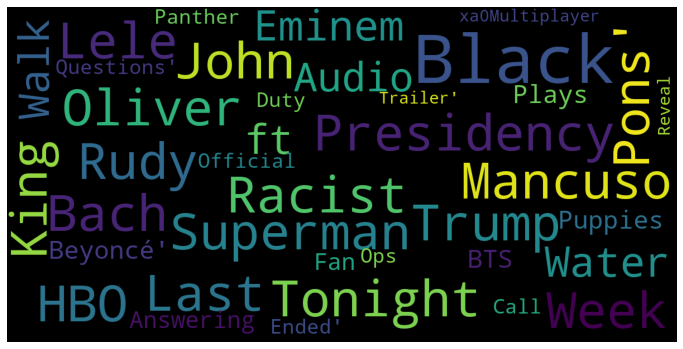

Title - Trend 0


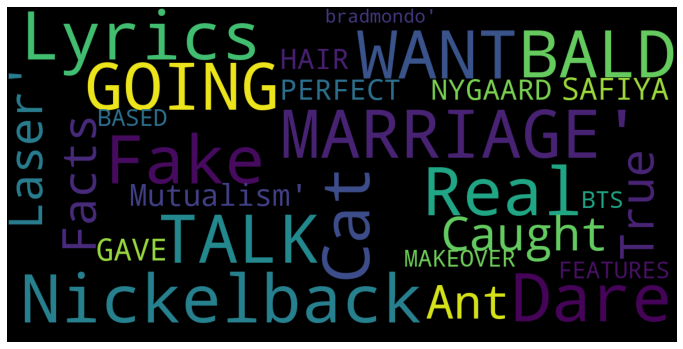

In [326]:
stopwords = set(STOPWORDS)
def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='black',
        stopwords=stopwords,
        max_words=200000,
        max_font_size=40, 
        scale=3,
        random_state=1).generate(str(data))
    
    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)
        
    plt.imshow(wordcloud)
    plt.show()
print("Title - Trend 1")
show_wordcloud(trend_1['title'].values)
print("Title - Trend 0")
show_wordcloud(trend_0['title'].values)
# learn about the wordcloud from the internet
# generating wordcloud of the title column for all 1 for trending and 0 for non trending

Tags - Trend 1


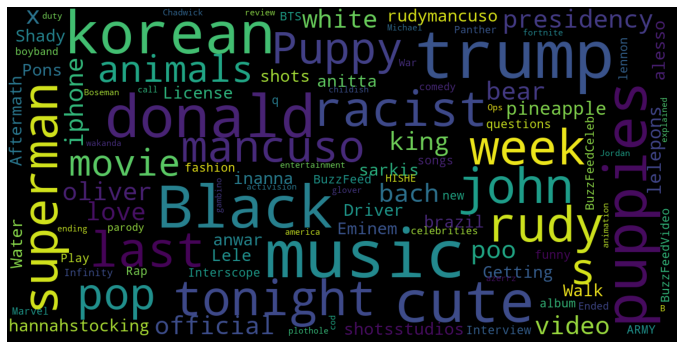

Tags - Trend 0


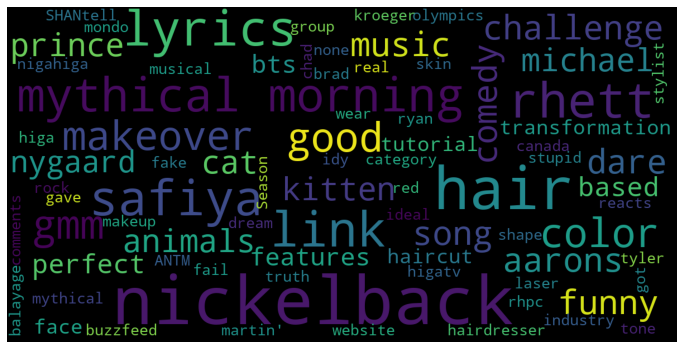

In [327]:
print("Tags - Trend 1")
show_wordcloud(trend_1['tags'].values)
print("Tags - Trend 0")
show_wordcloud(trend_0['tags'].values)
# generating wordcloud of the tags column for all 1 for trending and 0 for non trending

description - Trend 1


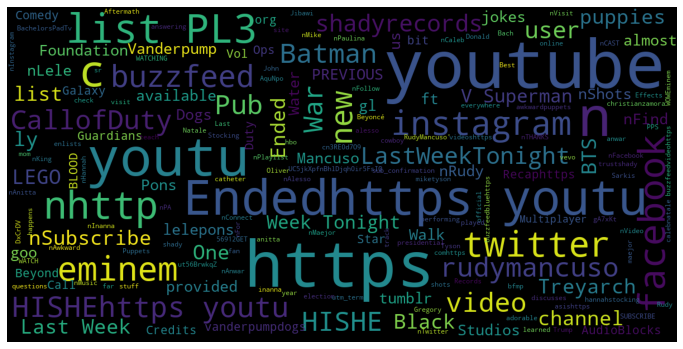

description - Trend 0


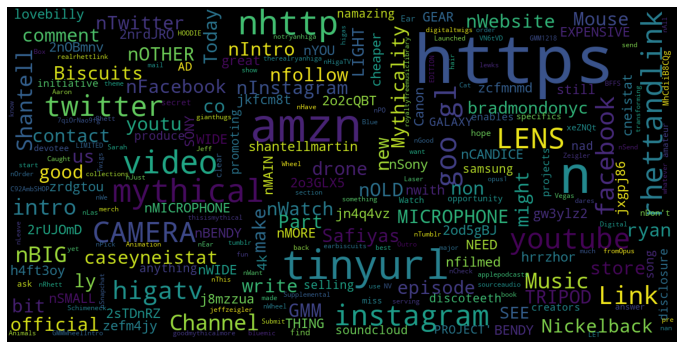

In [328]:
print("description - Trend 1")
show_wordcloud(trend_1['description'].values)
print("description - Trend 0")
show_wordcloud(trend_0['description'].values)
# generating wordcloud of the description column for all 1 for trending and 0 for non trending

<AxesSubplot:>

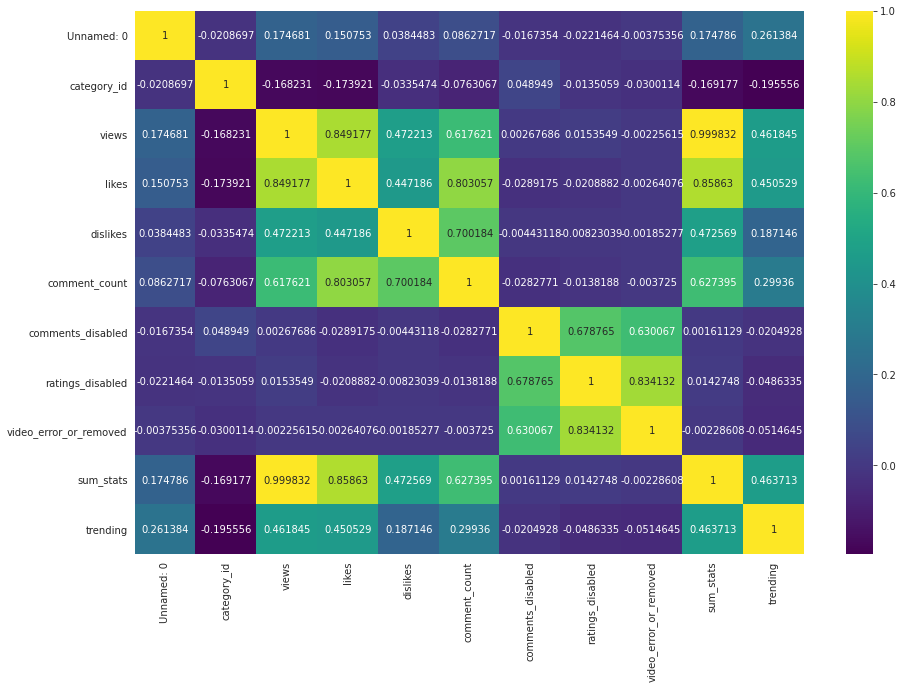

In [329]:
fig, ax = plt.subplots()
fig.set_size_inches(15, 10)
sns.heatmap(df.corr(),annot=True,cmap='viridis', fmt='g')
# sum_stats, likes and views columns are partially correlated with trending column

1. Music , Entertainment and comedy have the highest likes, dislikes comment_count

2. Music , Entertainment and Film & Animation have the highest views.

3. trending videos have the most views compared to non trending

4. Music, Entertainment and Film & Animation are the most trending categories.

Starting the feature engineering

In [330]:
fdf=df[['category','views','likes','dislikes','comment_count','sum_stats','trending']]
fdf
# getting the required columns and discarding the rest of the columns 

,category,views,likes,dislikes,comment_count,sum_stats,trending
0,People & Blogs,748374.0,57527.0,2966.0,15954.0,818889.0,0
1,Entertainment,2418783.0,97185.0,6146.0,12703.0,2522525.0,1
2,Comedy,3191434.0,146033.0,5339.0,8181.0,3340309.0,1
3,Entertainment,343168.0,10172.0,666.0,2146.0,354820.0,0
4,Entertainment,2095731.0,132235.0,1989.0,17518.0,2243495.0,0
...,...,...,...,...,...,...,...
41410,Pets & Animals,1685609.0,38160.0,1385.0,2657.0,1725041.0,0
41411,People & Blogs,1064798.0,60008.0,382.0,3936.0,1128360.0,0
41412,Entertainment,1066451.0,48068.0,1032.0,3992.0,1117479.0,0
41413,Film & Animation,5660813.0,192957.0,2846.0,13088.0,5864012.0,1


In [331]:
fdf['music_f']=np.where((fdf['category']=='Music'),1,0)
# creating feature of music category since it is the most trending category

In [332]:
fdf['views_f']=np.where(fdf['views']>fdf['views'].mean(),1,0)
fdf['likes_f']=np.where(fdf['likes']>fdf['likes'].mean(),1,0)
fdf['dislikes_f']=np.where(fdf['dislikes']>fdf['dislikes'].mean(),1,0)
fdf['cc_f']=np.where(fdf['comment_count']>fdf['comment_count'].mean(),1,0)

fdf
# since the videos being trending or not was decided based on the mean of sum_stats which was the sum of views 
# likes and comment_count and minus of dislikes, it is a good idea to feature engineering them the same way so that
# their correlation with trending column can get higher.

,category,views,likes,dislikes,comment_count,sum_stats,trending,music_f,views_f,likes_f,dislikes_f,cc_f
0,People & Blogs,748374.0,57527.0,2966.0,15954.0,818889.0,0,0,0,0,0,1
1,Entertainment,2418783.0,97185.0,6146.0,12703.0,2522525.0,1,0,1,1,1,1
2,Comedy,3191434.0,146033.0,5339.0,8181.0,3340309.0,1,0,1,1,1,0
3,Entertainment,343168.0,10172.0,666.0,2146.0,354820.0,0,0,0,0,0,0
4,Entertainment,2095731.0,132235.0,1989.0,17518.0,2243495.0,0,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...
41410,Pets & Animals,1685609.0,38160.0,1385.0,2657.0,1725041.0,0,0,0,0,0,0
41411,People & Blogs,1064798.0,60008.0,382.0,3936.0,1128360.0,0,0,0,0,0,0
41412,Entertainment,1066451.0,48068.0,1032.0,3992.0,1117479.0,0,0,0,0,0,0
41413,Film & Animation,5660813.0,192957.0,2846.0,13088.0,5864012.0,1,0,1,1,0,1


In [333]:
fdf.drop(['category','views', 'likes' ,'dislikes' ,'comment_count' ,'sum_stats'],axis=1,inplace=True)
# we are done feature engineering with the columns, now we can drop all of them

<AxesSubplot:>

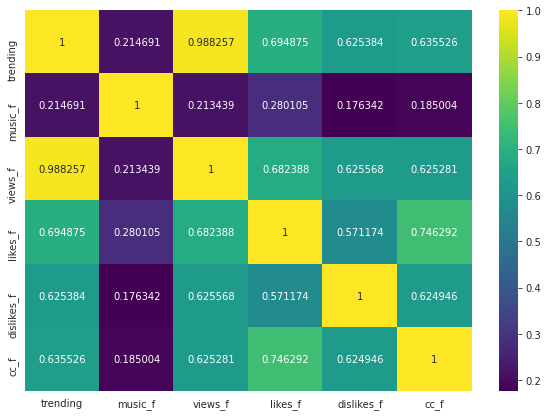

In [334]:
fig, ax = plt.subplots()
fig.set_size_inches(10 ,7)
sns.heatmap(fdf.corr(),annot=True,cmap='viridis', fmt='g')
# as you can see that resulting columns correlation have gotten alot better with the target column trending.

In [335]:
fdf
# our resulting data look like this, we dropped the ss_f column because the our label column was originated from
# sum_stats so it's not right add such column to avoid overfitting since it was completely correlated 

,trending,music_f,views_f,likes_f,dislikes_f,cc_f
0,0,0,0,0,0,1
1,1,0,1,1,1,1
2,1,0,1,1,1,0
3,0,0,0,0,0,0
4,0,0,0,1,0,1
...,...,...,...,...,...,...
41410,0,0,0,0,0,0
41411,0,0,0,0,0,0
41412,0,0,0,0,0,0
41413,1,0,1,1,0,1


In [336]:
X2=fdf[['music_f' ,'likes_f' ,'dislikes_f' ,'cc_f']]
y2=fdf['trending']
# , 'views_f'
# we did not use the views_f column because it was causing the models to overfitt, we aim to create a more 
# generalized data for our models 
# separating the target or dependent column from the independent columns or features 

In [337]:
X_train, X_test, y_train, y_test = train_test_split(X2, y2, test_size=0.3,random_state=42)
# splitting the data to xtrain , xtest and ytrain , ytest

Logistic Regression

In [338]:
logreg = LogisticRegression()
logreg.fit(X_train,y_train)
# training the Logistics regression model

LogisticRegression()

In [339]:
lr_pred = logreg.predict(X_test)
accuracy_score(lr_pred, y_test) * 100
# predicting the trend and calculating the accuracy

90.4225352112676

In [340]:
cv_scores = cross_val_score(logreg,X2,y2,cv=5)
np.mean(cv_scores)*100
# calculating cross validation score of the dataset

90.68453458891706

In [341]:
confusion_matrix(y_test,lr_pred)
# calculating confusion matrix 

array([[9569,  340],
       [ 850, 1666]])

In [342]:
print(classification_report(y_test,lr_pred))
# complete performance metric report of the logistic regression

              precision    recall  f1-score   support

           0       0.92      0.97      0.94      9909
           1       0.83      0.66      0.74      2516

    accuracy                           0.90     12425
   macro avg       0.87      0.81      0.84     12425
weighted avg       0.90      0.90      0.90     12425



In [373]:
lr = pd.DataFrame({'Actual': y_test, 'Predicted': lr_pred})
categories=[]
for i in lr.index:
    categories.append(df.iloc[i,15])

cats=pd.DataFrame(categories)
cats=cats.set_index(lr.index)

lr['categories']=cats

lr=lr.dropna(axis=0)

lr_trend=lr.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)

px.bar(lr_trend,barmode='group',labels={'value':'trend level'},title='Logistic Regression')
# visualizing the predictions 

In [344]:
lr.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)
# data which our above visualization is based on.

,Predicted,Actual
categories,,
Music,677,764
Entertainment,367,575
Comedy,207,211
People & Blogs,170,185
Howto & Style,141,135
Film & Animation,136,190
Gaming,87,93
Science & Technology,83,113
Sports,73,130


Decision Tree Classifier

In [345]:
decisiontree = DecisionTreeClassifier(random_state=0)
dep = np.arange(1,10)
param_grid = {'max_depth' : dep}

clf_cv = GridSearchCV(decisiontree, param_grid=param_grid, cv=5)

clf_cv.fit(X_train,y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=0),
             param_grid={'max_depth': array([1, 2, 3, 4, 5, 6, 7, 8, 9])})

In [346]:
dt_pred=clf_cv.predict(X_test)

clf_cv.best_params_,clf_cv.best_score_*100
print('Best value of max_depth:',clf_cv.best_params_)
# print('Accuracy:',clf_cv.best_score_*100)
accuracy_score(dt_pred, y_test) * 100

Best value of max_depth: {'max_depth': 3}


90.45472837022133

In [347]:
cv_scores = cross_val_score(decisiontree,X2,y2,cv=5)
np.mean(cv_scores)*100

90.72799710249907

In [348]:
confusion_matrix(y_test,dt_pred)

array([[9573,  336],
       [ 850, 1666]])

In [349]:
print(classification_report(y_test,dt_pred))

              precision    recall  f1-score   support

           0       0.92      0.97      0.94      9909
           1       0.83      0.66      0.74      2516

    accuracy                           0.90     12425
   macro avg       0.88      0.81      0.84     12425
weighted avg       0.90      0.90      0.90     12425



In [376]:
dt = pd.DataFrame({'Actual': y_test, 'Predicted': dt_pred})

# categories=[]
# for i in dt.index:
#     categories.append(df.iloc[i,15])

cats=pd.DataFrame(categories)
cats=cats.set_index(dt.index)

dt['categories']=cats

dt=dt.dropna(axis=0)

dt_trend=dt.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)

px.bar(dt_trend,barmode='group',labels={'value':'trend level'},title='Decision Tree Classifier')

In [351]:
dt.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)

,Predicted,Actual
categories,,
Music,673,764
Entertainment,367,575
Comedy,207,211
People & Blogs,170,185
Howto & Style,141,135
Film & Animation,136,190
Gaming,87,93
Science & Technology,83,113
Sports,73,130


random forest classifier

In [352]:
random_forest = RandomForestClassifier()
ne = np.arange(1,20)
param_grid = {'n_estimators' : ne}

rf_cv = GridSearchCV(random_forest, param_grid=param_grid, cv=5)

rf_cv.fit(X_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'n_estimators': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19])})

In [353]:
rf_pred=rf_cv.predict(X_test)

rf_cv.best_params_,rf_cv.best_score_*100
print('Best value of max_depth:',rf_cv.best_params_)
accuracy_score(rf_pred, y_test) * 100

Best value of max_depth: {'n_estimators': 6}


90.45472837022133

In [354]:
cv_scores = cross_val_score(random_forest,X2,y2,cv=5)
np.mean(cv_scores)*100

90.70868042979596

In [355]:
confusion_matrix(y_test,rf_pred)

array([[9573,  336],
       [ 850, 1666]])

In [356]:
print(classification_report(y_test,rf_pred))

              precision    recall  f1-score   support

           0       0.92      0.97      0.94      9909
           1       0.83      0.66      0.74      2516

    accuracy                           0.90     12425
   macro avg       0.88      0.81      0.84     12425
weighted avg       0.90      0.90      0.90     12425



In [377]:
rf = pd.DataFrame({'Actual': y_test, 'Predicted': rf_pred})

cats=pd.DataFrame(categories)
cats=cats.set_index(rf.index)

rf['categories']=cats

rf=rf.dropna(axis=0)

rf_trend=rf.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)

px.bar(rf_trend,barmode='group',labels={'value':'trend level'},title='Random Forest Classifier')

In [358]:
rf.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)

,Predicted,Actual
categories,,
Music,673,764
Entertainment,367,575
Comedy,207,211
People & Blogs,170,185
Howto & Style,141,135
Film & Animation,136,190
Gaming,87,93
Science & Technology,83,113
Sports,73,130


Gradient boosting classfier

In [359]:
gbk = GradientBoostingClassifier()
ne = np.arange(1,20)
dep = np.arange(1,10)
param_grid = {'n_estimators' : ne,'max_depth' : dep}

gbk_cv = GridSearchCV(gbk, param_grid=param_grid, cv=5)

gbk_cv.fit(X_train,y_train)

GridSearchCV(cv=5, estimator=GradientBoostingClassifier(),
             param_grid={'max_depth': array([1, 2, 3, 4, 5, 6, 7, 8, 9]),
                         'n_estimators': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19])})

In [360]:
gbk_pred=rf_cv.predict(X_test)

print('Best value of parameters:',gbk_cv.best_params_)
print('Best score:',gbk_cv.best_score_*100)

Best value of parameters: {'max_depth': 2, 'n_estimators': 19}
Best score: 90.9486029665402


In [361]:
cv_scores = cross_val_score(gbk,X2,y2,cv=5)
np.mean(cv_scores)*100

90.67970542074126

In [362]:
confusion_matrix(y_test,gbk_pred)

array([[9573,  336],
       [ 850, 1666]])

In [363]:
print(classification_report(y_test,gbk_pred))

              precision    recall  f1-score   support

           0       0.92      0.97      0.94      9909
           1       0.83      0.66      0.74      2516

    accuracy                           0.90     12425
   macro avg       0.88      0.81      0.84     12425
weighted avg       0.90      0.90      0.90     12425



In [378]:
gbks = pd.DataFrame({'Actual': y_test, 'Predicted': gbk_pred})

cats=pd.DataFrame(categories)
cats=cats.set_index(gbks.index)

gbks['categories']=cats

gbks=gbks.dropna(axis=0)

gbks_trend=gbks.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)

px.bar(gbks_trend,barmode='group',labels={'value':'trend level'},title='Gradient Boosting Classifier')

In [365]:
gbks.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)

,Predicted,Actual
categories,,
Music,673,764
Entertainment,367,575
Comedy,207,211
People & Blogs,170,185
Howto & Style,141,135
Film & Animation,136,190
Gaming,87,93
Science & Technology,83,113
Sports,73,130


K nearest neighbor

In [366]:
knn = KNeighborsClassifier( )
k_range = list(range(1,10))
weights_options = ['uniform','distance']
k_grid = dict(n_neighbors=k_range, weights = weights_options)
grid = GridSearchCV(knn, k_grid, cv=10, scoring = 'precision')
grid.fit(X_train,y_train)

GridSearchCV(cv=10, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9],
                         'weights': ['uniform', 'distance']},
             scoring='precision')

In [367]:
knn_pred=grid.predict(X_test)
print('Best value of parameters:',grid.best_params_)
print('Best score:',grid.best_score_*100)

Best value of parameters: {'n_neighbors': 4, 'weights': 'uniform'}
Best score: 85.18813316072207


In [368]:
cv_scores = cross_val_score(knn,X2,y2,cv=5)
np.mean(cv_scores)*100

90.66038874803814

In [369]:
confusion_matrix(y_test,knn_pred)

array([[9741,  168],
       [1104, 1412]])

In [370]:
print(classification_report(y_test,knn_pred))

              precision    recall  f1-score   support

           0       0.90      0.98      0.94      9909
           1       0.89      0.56      0.69      2516

    accuracy                           0.90     12425
   macro avg       0.90      0.77      0.81     12425
weighted avg       0.90      0.90      0.89     12425



In [379]:
knns = pd.DataFrame({'Actual': y_test, 'Predicted': knn_pred})

cats=pd.DataFrame(categories)
cats=cats.set_index(knns.index)

knns['categories']=cats

knns=knns.dropna(axis=0)

knns_trend=knns.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)

px.bar(knns_trend,barmode='group',labels={'value':'trend level'},title='K Nearest Neighbor Classifier')

In [372]:
knns.groupby('categories')[['Predicted','Actual']].sum().sort_values(by='Predicted',ascending=False)

,Predicted,Actual
categories,,
Music,733,764
Entertainment,266,575
Comedy,110,211
Film & Animation,107,190
People & Blogs,93,185
Gaming,68,93
Sports,66,130
Howto & Style,61,135
Science & Technology,53,113
